In [1]:
import glob
import json
import datetime
from dateutil import parser

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation

from IPython.display import HTML, Image, Video

%config InlineBackend.figure_format = 'retina'
plt.style.use('seaborn-pastel')
#plt.style.use('style.mplstyle')

#!brew install ffmpeg      # MPE4 animations
#!brew install imagemagick  # Gif animations

In [2]:
import json
import datetime
from dateutil import parser

def process_json_file(filename):
    with open(filename, 'r') as file:
        buy_and_sell_curves_raw = json.load(file)
        for buy_and_sell_curve in buy_and_sell_curves_raw:
            buy_and_sell_curve["date_time"] = parser.parse(buy_and_sell_curve["date_time"], yearfirst=True)
            buy_and_sell_curve["buy_curve"] = pd.DataFrame(buy_and_sell_curve["buy_curve"], columns=["Price", "Volume"])
            buy_and_sell_curve["sell_curve"] = pd.DataFrame(buy_and_sell_curve["sell_curve"], columns=["Price", "Volume"])

            date_time = buy_and_sell_curve["date_time"]
            if date_time not in buy_and_sell_curves_date:
                buy_and_sell_curves_date[date_time] = True
                buy_and_sell_curves.append(buy_and_sell_curve)
            else:
                print(date_time, "duplicate")

In [4]:
buy_and_sell_curves = []
buy_and_sell_curves_date = {}

years = [2019, 2020]

for year in years:
    process_json_file('gitignore/data-%i.json' % year)

#process_json_file('gitignore/data.json')
#process_json_file('gitignore/data-justnew.json')

buy_and_sell_curves = sorted(buy_and_sell_curves, key=lambda item: item["date_time"])

In [5]:
class Plot():
    def __init__(
                self, 
                buy_and_sell_curves,
                title,
                title2,
                source="Jon Tingvold",
                draw_past_interactions=True, 
                dpi=200, 
                points_back_in_time=24*7
            ):

        self.buy_and_sell_curves = buy_and_sell_curves
        self.draw_past_interactions = draw_past_interactions
        self.points_back_in_time = points_back_in_time
        
        # Variables
        self.fig = None
        self.ax = None
        self.line1 = None
        self.line2 = None
        self.line3 = None
        self.intersections = None
        self.past_intersections = None

        self.text_date = None
        self.text_price = None
        self.text_volume = None
        self.text_imported = None

        self.past_interacton_volume = None
        self.past_interacton_price = None
        
        #plt.rcParams['savefig.pad_inches'] = 0.4
        plt.rcParams["font.family"] = "Gill Sans"
        plt.rcParams["figure.facecolor"] = "ffffff"
        plt.rcParams["axes.facecolor"] = "ffffff"
        
        self.fig = plt.figure(figsize=(6.4, 3.6), dpi=dpi)
        self.ax = plt.axes(xlim=(0, 80000), ylim=(-20, 100))
        
        
        plt.margins(0.4, tight=False)

        self.ax.spines['top'].set_visible(False)
        self.ax.spines['right'].set_visible(False)
        self.ax.spines['bottom'].set_visible(True)
        self.ax.spines['left'].set_visible(True)
        
        self.ax.axhline(y=0, color="lightgray", lw=0.5)

        self.fig.text(0.05, 0.90, title, fontsize="x-large", weight="bold")
        self.fig.text(0.05, 0.85, title2)
        self.fig.text(0.90, 0.05, source, ha="right")
        plt.subplots_adjust(top=0.75, bottom=0.2)

        plt.xlabel("Volume (MW)")
        plt.ylabel("Power price (EUR/MWh)")

        self.text_date = self.ax.text(78000, 96, "", ha="right")
        self.text_price = self.ax.text(78000, 86, "", ha="right")
        self.text_volume = self.ax.text(78000, 76, "", ha="right")
        self.text_imported = self.ax.text(78000, 66, "", ha="right")

        self.line1, = self.ax.plot([], [], lw=3)
        self.line2, = self.ax.plot([], [], lw=1, color = '#94C7FD')
        self.line3, = self.ax.plot([], [], lw=3)
        
        self.past_interacton_volume = []
        self.past_interacton_price = []
        self.past_intersections, = self.ax.plot([], [], 'o', alpha=0.1, markersize=3)
        self.intersections, = self.ax.plot([], [], 'o')
        
        self.line1.set_label('Buy curve')
        self.line2.set_label('/w ex-/import')
        self.line3.set_label('Sell curve')
        self.ax.legend(loc='lower right', frameon=False)

    def init(self):
        self.line1.set_data([], [])
        self.line2.set_data([], [])
        self.line3.set_data([], [])
        self.past_intersections.set_data([], [])
        self.intersections.set_data([], [])

        return self.line1, self.line2, self.line3, self.past_intersections, self.intersections,

    def animate(self, i):
        date_time = self.buy_and_sell_curves[i]["date_time"]
        buy_curve = self.buy_and_sell_curves[i]["buy_curve"]
        sell_curve = self.buy_and_sell_curves[i]["sell_curve"]
        
        imported_volume = self.buy_and_sell_curves[i]["imported_volume_volume"]
        accepted_buy_volume = self.buy_and_sell_curves[i]["accepted_buy_volume"]
        accepted_sell_volume = self.buy_and_sell_curves[i]["accepted_sell_volume"]
        volume = self.buy_and_sell_curves[i]["volume"]
        price = self.buy_and_sell_curves[i]["price"]

        date_time_str = date_time.strftime("%Y-%m-%d %H:%M")
        self.text_date.set_text(date_time_str)
        self.text_price.set_text(" %4.1f EUR/MWh" % price)
        self.text_volume.set_text("%d MW produced" % round(volume, -3))
        self.text_imported.set_text("%d MW exported" % round(-1 * imported_volume, -2))

        self.line1.set_data(buy_curve["Volume"] + imported_volume, buy_curve["Price"])
        self.line2.set_data(buy_curve["Volume"], buy_curve["Price"])
        self.line3.set_data(sell_curve["Volume"], sell_curve["Price"])

        if self.draw_past_interactions:
            self.past_intersections.set_data(self.past_interacton_volume[-1*self.points_back_in_time:], self.past_interacton_price[-1*self.points_back_in_time:])
            self.past_interacton_volume.append(volume)
            self.past_interacton_price.append(price)

        self.intersections.set_data(volume, price)

        return self.line1, self.line2, self.line3, self.past_intersections, self.intersections,
        
def save_image(buy_and_sell_curves, path, title, title2, dpi=100):
    plot = Plot(buy_and_sell_curves, title, title2, dpi=dpi)
    plot.animate(0)
    plot.fig.savefig(path, dpi=200)
    plt.close()

def save_and_render_video(buy_and_sell_curves, path, title, title2, draw_past_interactions=False, points_back_in_time=7*24):
    plot = Plot(buy_and_sell_curves, title, title2, draw_past_interactions=draw_past_interactions, points_back_in_time=points_back_in_time)
    frames = len(buy_and_sell_curves)
    anim = animation.FuncAnimation(plot.fig, plot.animate, init_func=plot.init, frames=frames, blit=True)
    anim.save(path, writer = animation.FFMpegWriter(fps = 10, codec='h264'))
    plt.close()
    
def save_and_render_gif(buy_and_sell_curves, path, title, title2, draw_past_interactions=False, points_back_in_time=7*24):
    plot = Plot(buy_and_sell_curves, title, title2, draw_past_interactions=draw_past_interactions, points_back_in_time=points_back_in_time)
    frames = len(buy_and_sell_curves)
    anim = animation.FuncAnimation(plot.fig, plot.animate, init_func=plot.init, frames=frames, blit=True)
    anim.save(path, writer = animation.ImageMagickWriter(fps = 10, codec='h264'))
    plt.close()

## Render animations

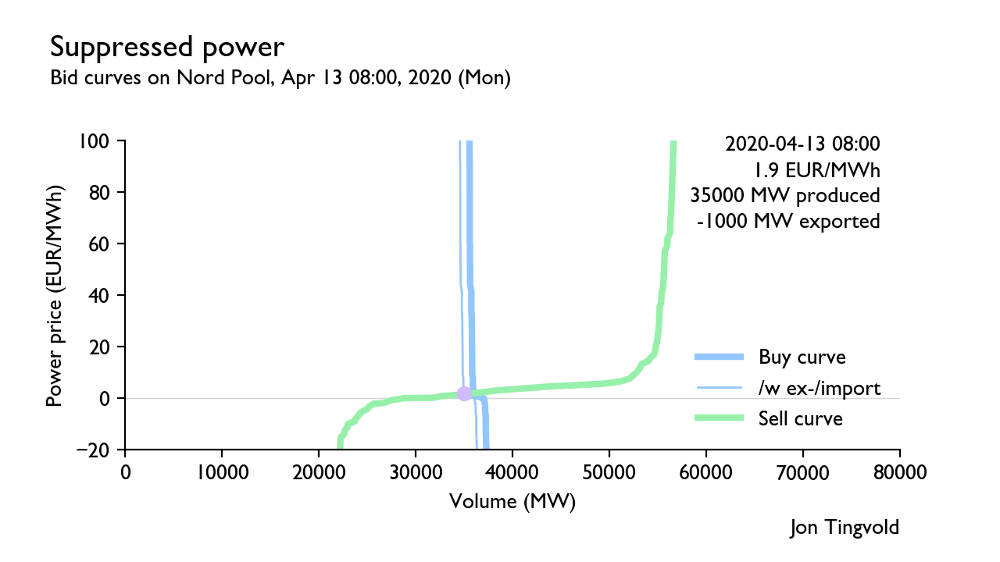

In [48]:
# PNG image of last day 8:00

last_hour = buy_and_sell_curves[-1]["date_time"]

date_time = datetime.datetime(last_hour.year, last_hour.month, last_hour.day, 8, 0)

title = "Suppressed power"
title2 = "Bid curves on Nord Pool, %s" % date_time.strftime('%b %d %H:%M, %Y (%a)')
path = "animations/Last day 8am.png"

buy_and_sell_curve_for_plot = [buy_and_sell_curve for buy_and_sell_curve in buy_and_sell_curves 
     if   buy_and_sell_curve["date_time"] == date_time]

save_image(buy_and_sell_curve_for_plot, path, title, title2, dpi=100)
Image(path, retina=True)

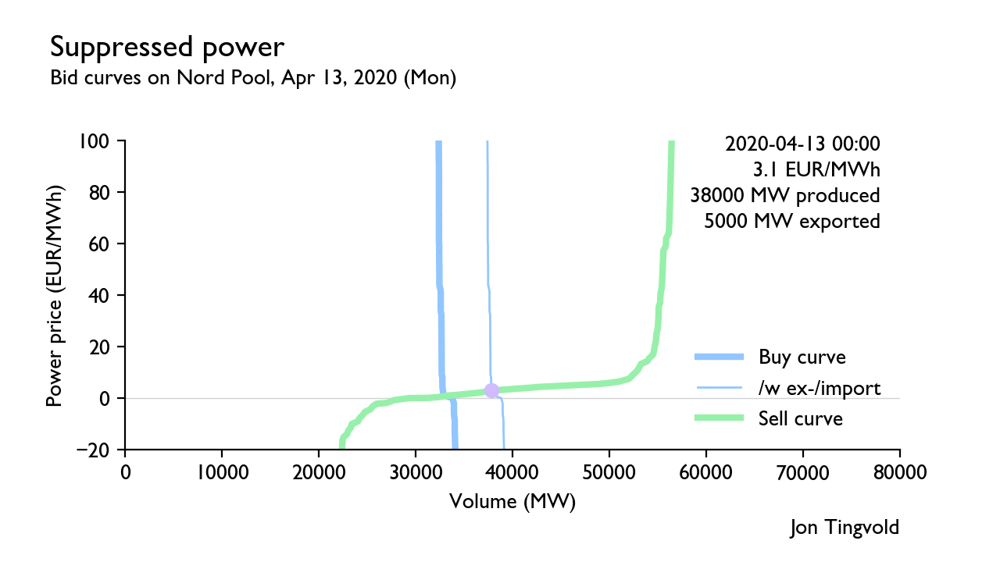

In [49]:
# Gif animation of last day

last_hour = buy_and_sell_curves[-1]["date_time"]

from_date = datetime.datetime(last_hour.year, last_hour.month, last_hour.day, 0, 0)
to_date = datetime.datetime(last_hour.year, last_hour.month, last_hour.day, 23, 0)

title = "Suppressed power"
title2 = "Bid curves on Nord Pool, %s" % from_date.strftime('%b %d, %Y (%a)')
path = "animations/Last day.gif"

buy_and_sell_curve_for_plot = [
    buy_and_sell_curve for buy_and_sell_curve in buy_and_sell_curves 
        if   buy_and_sell_curve["date_time"] >= from_date
        and  buy_and_sell_curve["date_time"] <= to_date
]

save_and_render_gif(buy_and_sell_curve_for_plot, path, title, title2, draw_past_interactions=False)
Image(path, retina=True)

In [47]:
# Last week

last_hour = buy_and_sell_curves[-1]["date_time"]

from_date = last_hour - datetime.timedelta(days=(last_hour.weekday() + 7)) - datetime.timedelta(hours=last_hour.hour)
to_date = last_hour - datetime.timedelta(days=(last_hour.weekday() + 1))

title = "Supply and demand"
title2 = "Bid curves on Nord Pool, %s–%s (Mon–Sun)" % (from_date.strftime('%B %d'), to_date.strftime('%B %d, %Y'))
path = "animations/Last week.mp4"

buy_and_sell_curve_for_plot = [buy_and_sell_curve for buy_and_sell_curve in buy_and_sell_curves 
     if   buy_and_sell_curve["date_time"] >= from_date
     and  buy_and_sell_curve["date_time"] <= to_date]

save_and_render_video(buy_and_sell_curve_for_plot, path, title=title, title2=title2, draw_past_interactions=True, points_back_in_time=7*24)
HTML("""<video src="{}" width="640" height="360" controls="true">""".format(path))

### A normal week in March

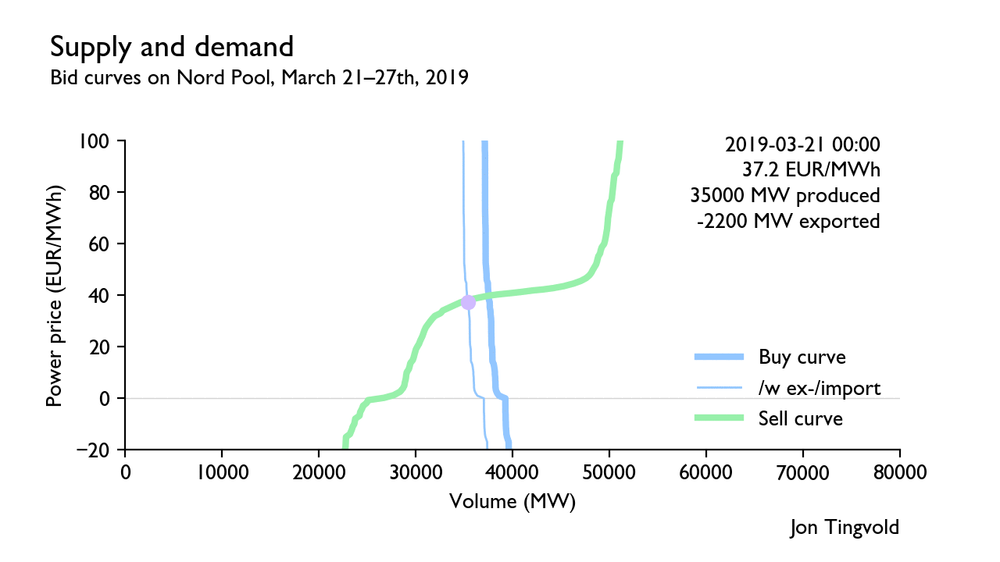

In [42]:
buy_and_sell_curve_for_plot = [buy_and_sell_curve for buy_and_sell_curve in buy_and_sell_curves 
     if   buy_and_sell_curve["date_time"] >= datetime.datetime(2019, 3, 21, 0, 0)
     and  buy_and_sell_curve["date_time"] <= datetime.datetime(2019, 3, 27, 23, 0)]

title = "Supply and demand"
title2 = "Bid curves on Nord Pool, March 21–27th, 2019"
path = "animations/1-normal-week-in-march.gif"
save_and_render_gif(buy_and_sell_curve_for_plot, path, title, title2, draw_past_interactions=True, points_back_in_time=7*24)
Image(path, retina=True)

### A week with high prices in December

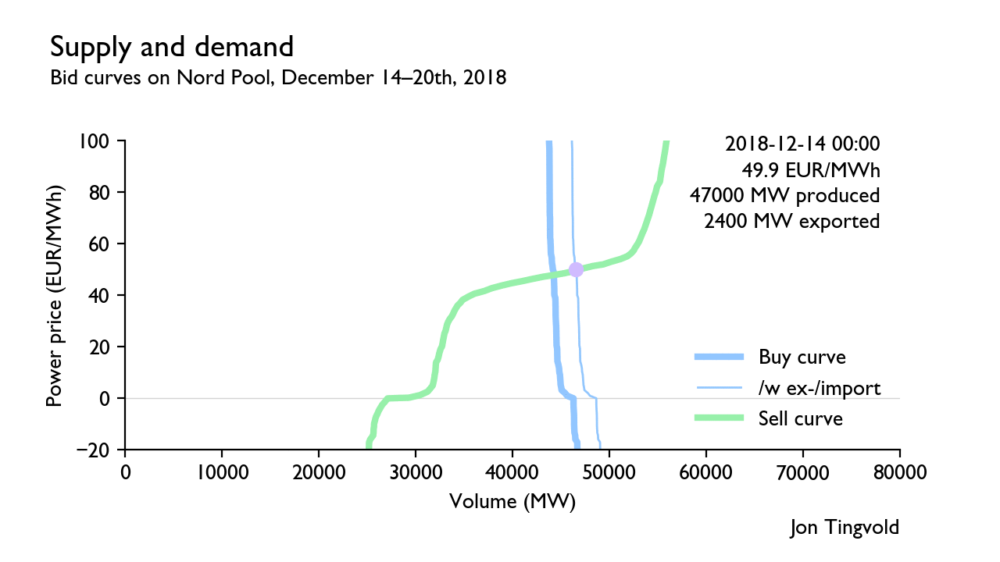

In [43]:
buy_and_sell_curve_for_plot = [buy_and_sell_curve for buy_and_sell_curve in buy_and_sell_curves 
     if   buy_and_sell_curve["date_time"] >= datetime.datetime(2018, 12, 14, 0, 0)
     and  buy_and_sell_curve["date_time"] <= datetime.datetime(2018, 12, 20, 23, 0)]

title = "Supply and demand"
title2 = "Bid curves on Nord Pool, December 14–20th, 2018"
path = "animations/2-high-price-week-in-december.gif"
save_and_render_gif(buy_and_sell_curve_for_plot, path, title, title2, draw_past_interactions=True, points_back_in_time=7*24)
Image(path, retina=True)

### A week with low prices in June

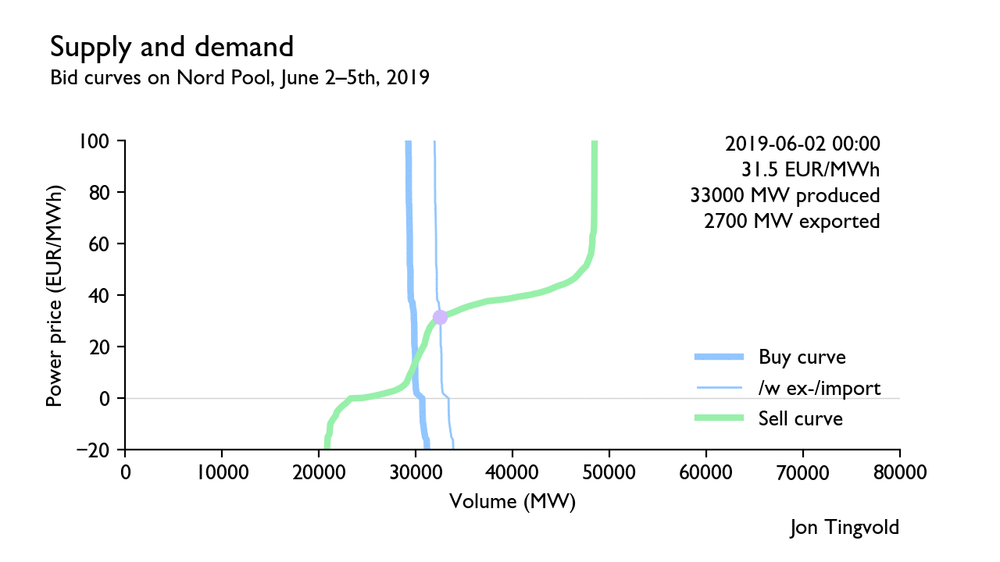

In [44]:
buy_and_sell_curve_for_plot = [buy_and_sell_curve for buy_and_sell_curve in buy_and_sell_curves 
     if   buy_and_sell_curve["date_time"] >= datetime.datetime(2019, 6, 2, 0, 0)
     and  buy_and_sell_curve["date_time"] <= datetime.datetime(2019, 6, 5, 23, 0)]

title = "Supply and demand"
title2 = "Bid curves on Nord Pool, June 2–5th, 2019"
path = "animations/3-low-price-week-in-march.gif"
save_and_render_gif(buy_and_sell_curve_for_plot, path, title, title2, draw_past_interactions=True, points_back_in_time=7*24)
Image(path, retina=True)

### A normal hour with low demand, June 6th 12pm

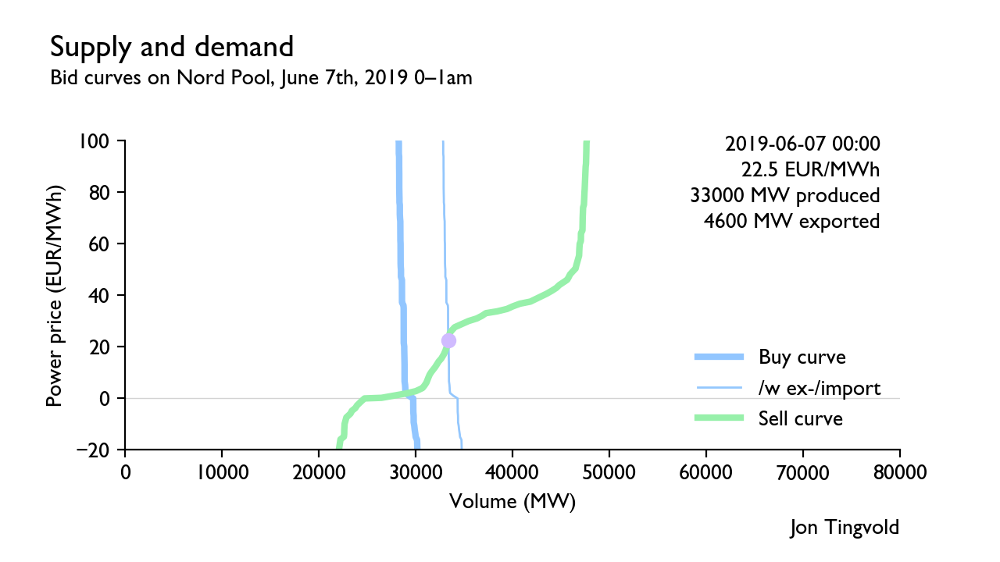

In [7]:
buy_and_sell_curve_for_plot = [buy_and_sell_curve for buy_and_sell_curve in buy_and_sell_curves 
     if   buy_and_sell_curve["date_time"] == datetime.datetime(2019, 6, 7, 0, 0)]

title = "Supply and demand"
title2 = "Bid curves on Nord Pool, June 7th, 2019 0–1am"
path = "animations/4-2019-06-07-0000.png"
save_image(buy_and_sell_curve_for_plot, path, title, title2, dpi=100)
Image(path, retina=True)

## Get power by source

In [8]:
import sqlite3
path = "../../../2019/Power price analysis/data/Viktigste data.sqlite"
conn = sqlite3.connect(path)

In [9]:
df = pd.read_sql_query("""SELECT 
	DateTime,

	SUM(Nuclear) 
        AS Nuclear,
        
    SUM(Waste)
        AS Waste,
        
    SUM("Geothermal")
    +SUM(Other) 
    +SUM("Other renewable") 
    +SUM("Marine") 
        AS "Other",

    SUM(Solar) 
        AS Solar,

    SUM("Wind Onshore") 
    +SUM("Wind Offshore") 
        AS Wind,
    
    SUM("Hydro Run-of-river and poundage") 
        AS Rivers,
        
    SUM(Biomass)
        AS Bio,

    SUM("Fossil Brown coal/Lignite") 
    +SUM("Fossil Hard coal")
    +SUM("Fossil Coal-derived gas") 
        AS Coal,
        
    SUM("Fossil Gas") 
        AS Gas,
        
    SUM("Fossil Oil") 
    +SUM("Fossil Oil shale") 
    +SUM("Fossil Peat") 
        AS OtherFossil,

    SUM("Hydro Water Reservoir") 
    +SUM("Hydro Pumped Storage Production") 
        AS "Hydro",

    SUM("Hydro Pumped Storage Consumption") 
        AS "Pumped hydro consumption",
    

	SUM(Nuclear) 
	+SUM(Solar) 
	+SUM("Wind Onshore") 
	+SUM("Wind Offshore") 
	+SUM("Fossil Brown coal/Lignite") 
	+SUM("Fossil Hard coal") 
	+SUM("Fossil Coal-derived gas") 
	+SUM("Fossil Oil") 
	+SUM("Fossil Gas") 
	+SUM("Fossil Oil shale") 
	+SUM("Fossil Peat") 
	+SUM(Biomass) 
	+SUM(Waste)
	+SUM(Other) 
	+SUM("Other renewable") 
	+SUM("Marine") 
	+SUM("Geothermal") 
	+SUM("Hydro Run-of-river and poundage") 
	+SUM("Hydro Water Reservoir") 
	+SUM("Hydro Pumped Storage Production") 
		AS "Total"
	
FROM 
	"ActualConsumptionPerType"
WHERE 
	AreaName IN (
		"Denmark",
		"Estonia",
		"Finland",
		"Latvia",
		"Lithuania",
		"Norway",
		"Sweden"
	)
GROUP BY "DateTime"
ORDER BY "DateTime" ASC""", conn)
df.head()

,DateTime,Nuclear,Waste,Other,Solar,Wind,Rivers,Bio,Coal,Gas,OtherFossil,Hydro,Pumped hydro consumption,Total
0,2014-12-08 23:00:00.000,7979.0,0.0,1508.0,0.0,1483.0,0.0,0.0,0.0,0.0,0.0,5157.0,0.0,16127.0
1,2014-12-09 00:00:00.000,7980.0,0.0,1509.0,0.0,1485.0,0.0,0.0,0.0,0.0,0.0,4752.0,0.0,15726.0
2,2014-12-09 01:00:00.000,7981.0,0.0,1507.0,0.0,1494.0,0.0,0.0,0.0,0.0,0.0,4645.0,0.0,15627.0
3,2014-12-09 02:00:00.000,7980.0,0.0,1509.0,0.0,1511.0,0.0,0.0,0.0,0.0,0.0,4814.0,0.0,15814.0
4,2014-12-09 03:00:00.000,7980.0,0.0,1510.0,0.0,1550.0,0.0,0.0,0.0,0.0,0.0,5372.0,0.0,16412.0


## Experiment: Create marginal cost curve

In [10]:
actual_generation_per_type = {}
for index, row in df.iterrows():
    date_time = datetime.datetime.strptime(row.DateTime, '%Y-%m-%d %H:%M:%S.%f')
    actual_generation_per_type[date_time] = row
    

for i in range(-300*24, -1*24):
    date_time = buy_and_sell_curves[i]["date_time"]

    if date_time in actual_generation_per_type:
        g_per_t = actual_generation_per_type[date_time]
        ideal_sell_curve = pd.DataFrame(columns=["Price", "Volume"])
        volume = 0
        
        ideal_sell_curve = ideal_sell_curve.append([{"Price": -500.0, "Volume": volume}])
        volume += g_per_t["Nuclear"]
        ideal_sell_curve = ideal_sell_curve.append({"Price": -500.0, "Volume": volume}, ignore_index=True)
        
        ideal_sell_curve = ideal_sell_curve.append([{"Price": -5.0, "Volume": volume}])
        volume += g_per_t["Waste"] + g_per_t["Other"]
        ideal_sell_curve = ideal_sell_curve.append({"Price": -4.0, "Volume": volume}, ignore_index=True)
        
        ideal_sell_curve = ideal_sell_curve.append([{"Price": -1.0, "Volume": volume}])
        volume += g_per_t["Solar"]
        ideal_sell_curve = ideal_sell_curve.append({"Price": -1.0, "Volume": volume}, ignore_index=True)
        
        ideal_sell_curve = ideal_sell_curve.append([{"Price": 0.0, "Volume": volume}])
        volume += g_per_t["Wind"]
        ideal_sell_curve = ideal_sell_curve.append({"Price": 0.5, "Volume": volume}, ignore_index=True)
        
        ideal_sell_curve = ideal_sell_curve.append([{"Price": 1.0, "Volume": volume}])
        volume += g_per_t["Rivers"]
        ideal_sell_curve = ideal_sell_curve.append({"Price": 1.5, "Volume": volume}, ignore_index=True)

        ideal_sell_curve = ideal_sell_curve.append([{"Price": 20.0, "Volume": volume}])
        volume += g_per_t["Bio"]
        ideal_sell_curve = ideal_sell_curve.append([{"Price": 22.0, "Volume": volume}])
        
        ideal_sell_curve = ideal_sell_curve.append([{"Price": 38.0, "Volume": volume}])
        volume += g_per_t["Hydro"]
        ideal_sell_curve = ideal_sell_curve.append([{"Price": 42.0, "Volume": volume}])
        
        ideal_sell_curve = ideal_sell_curve.append([{"Price": 41.0, "Volume": volume}])
        volume += g_per_t["Gas"]
        ideal_sell_curve = ideal_sell_curve.append([{"Price": 42.0, "Volume": volume}])
        
        ideal_sell_curve = ideal_sell_curve.append([{"Price": 45.0, "Volume": volume}])
        volume += g_per_t["OtherFossil"]
        ideal_sell_curve = ideal_sell_curve.append([{"Price": 46.0, "Volume": volume}])
        
        ideal_sell_curve = ideal_sell_curve.append([{"Price": 50.0, "Volume": volume}])
        volume += g_per_t["Coal"]
        ideal_sell_curve = ideal_sell_curve.append([{"Price": 51.0, "Volume": volume}])

        buy_and_sell_curves[i]["ideal_sell_curve"] = ideal_sell_curve
    else:
        buy_and_sell_curves[i]["ideal_sell_curve"] = None

In [11]:
class PlotWithMarginalCost():
    def __init__(self, buy_and_sell_curves, title, title2, source="Jon Tingvold", draw_past_interactions=True, dpi=200, points_back_in_time = 24*7):
        self.buy_and_sell_curves = buy_and_sell_curves
        self.draw_past_interactions = draw_past_interactions
        self.points_back_in_time = points_back_in_time
        
        # Variables
        self.fig = None
        self.ax = None
        self.line1 = None
        self.line2 = None
        self.line3 = None
        self.intersections = None
        self.past_intersections = None

        self.text_date = None
        self.text_price = None
        self.text_volume = None
        self.text_imported = None

        self.past_interacton_volume = None
        self.past_interacton_price = None
        
        #plt.rcParams['savefig.pad_inches'] = 0.4
        plt.rcParams["font.family"] = "Gill Sans"
        plt.rcParams["figure.facecolor"] = "ffffff"
        plt.rcParams["axes.facecolor"] = "ffffff"
        
        self.fig = plt.figure(figsize=(6.4, 3.6), dpi=dpi)
        self.ax = plt.axes(xlim=(0, 80000), ylim=(-20, 100))
        
        
        plt.margins(0.4, tight=False)

        self.ax.spines['top'].set_visible(False)
        self.ax.spines['right'].set_visible(False)
        self.ax.spines['bottom'].set_visible(True)
        self.ax.spines['left'].set_visible(True)
        
        self.ax.axhline(y=0, color="lightgray", lw=0.5)

        self.fig.text(0.05, 0.90, title, fontsize="x-large", weight="bold")
        self.fig.text(0.05, 0.85, title2)
        self.fig.text(0.90, 0.05, source, ha="right")
        plt.subplots_adjust(top=0.75, bottom=0.2)

        plt.xlabel("Volume (MW)")
        plt.ylabel("Power price (EUR/MWh)")

        self.text_date = self.ax.text(78000, 96, "", ha="right")
        self.text_price = self.ax.text(78000, 86, "", ha="right")
        self.text_volume = self.ax.text(78000, 76, "", ha="right")
        self.text_imported = self.ax.text(78000, 66, "", ha="right")

        self.line1, = self.ax.plot([], [], lw=3)
        self.line2, = self.ax.plot([], [], lw=1, color = '#94C7FD')
        self.line3, = self.ax.plot([], [], lw=3)
        self.intersections, = self.ax.plot([], [], 'o')
        self.line4, = self.ax.plot([], [], lw=1)
        self._dummy, = self.ax.plot([], [], lw=1)
        self.past_intersections, = self.ax.plot([], [], 'o', alpha=0.1, markersize=3)
        
        self.past_interacton_volume = []
        self.past_interacton_price = []
        
        self.line1.set_label('Buy curve')
        self.line2.set_label('/w ex-/import')
        self.line3.set_label('Sell curve')
        self.line4.set_label('Ideal sell curve')
        self.ax.legend(loc='lower right', frameon=False)

    def init(self):
        self.line1.set_data([], [])
        self.line2.set_data([], [])
        self.line3.set_data([], [])
        self.line4.set_data([], [])
        self.past_intersections.set_data([], [])
        self.intersections.set_data([], [])

        return self.line1, self.line2, self.intersections,

    def animate(self, i):
        date_time = self.buy_and_sell_curves[i]["date_time"]
        buy_curve = self.buy_and_sell_curves[i]["buy_curve"]
        sell_curve = self.buy_and_sell_curves[i]["sell_curve"]
        ideal_sell_curve = self.buy_and_sell_curves[i]["ideal_sell_curve"]
        
        imported_volume = self.buy_and_sell_curves[i]["imported_volume_volume"]
        accepted_buy_volume = self.buy_and_sell_curves[i]["accepted_buy_volume"]
        accepted_sell_volume = self.buy_and_sell_curves[i]["accepted_sell_volume"]
        volume = self.buy_and_sell_curves[i]["volume"]
        price = self.buy_and_sell_curves[i]["price"]

        date_time_str = date_time.strftime("%Y-%m-%d %H:%M")
        self.text_date.set_text(date_time_str)
        self.text_price.set_text(" %4.1f EUR/MWh" % price)
        self.text_volume.set_text("%d MW produced" % round(volume, -3))
        self.text_imported.set_text("%d MW exported" % round(-1 * imported_volume, -2))

        self.line1.set_data(buy_curve["Volume"] + imported_volume, buy_curve["Price"])
        self.line2.set_data(buy_curve["Volume"], buy_curve["Price"])
        self.line3.set_data(sell_curve["Volume"], sell_curve["Price"])
        self.line4.set_data(ideal_sell_curve["Volume"], ideal_sell_curve["Price"])

        if self.draw_past_interactions:
            self.past_intersections.set_data(self.past_interacton_volume[-1*self.points_back_in_time:], self.past_interacton_price[-1*self.points_back_in_time:])
            self.past_interacton_volume.append(volume)
            self.past_interacton_price.append(price)

        self.intersections.set_data(volume, price)

        return self.line1, self.line2, self.intersections,
        
def save_image_with_mc(buy_and_sell_curves, i, title, title2, dpi=100):
    plot = PlotWithMarginalCost(buy_and_sell_curves, title, title2, dpi=dpi)
    plot.animate(i)
    plot.fig.savefig(path, dpi=200)

def save_and_render_video_with_mc(buy_and_sell_curves, path, title, title2, draw_past_interactions=False, points_back_in_time=7*24):
    plot = PlotWithMarginalCost(buy_and_sell_curves, title, title2, draw_past_interactions, points_back_in_time=points_back_in_time)
    frames = len(buy_and_sell_curves)
    anim = animation.FuncAnimation(plot.fig, plot.animate, init_func=plot.init, frames=frames, blit=True)
    anim.save(path, writer = animation.FFMpegWriter(fps = 10, codec='h264'))
    plt.close()
    
def save_and_render_gif_with_mc(buy_and_sell_curves, path, title, title2, draw_past_interactions=False, points_back_in_time=7*24):
    plot = PlotWithMarginalCost(buy_and_sell_curves, title, title2, draw_past_interactions, points_back_in_time=points_back_in_time)
    frames = len(buy_and_sell_curves)
    anim = animation.FuncAnimation(plot.fig, plot.animate, init_func=plot.init, frames=frames, blit=True)
    anim.save(path, writer = animation.ImageMagickWriter(fps = 10, codec='h264'))
    plt.close()

KeyError: 'ideal_sell_curve'

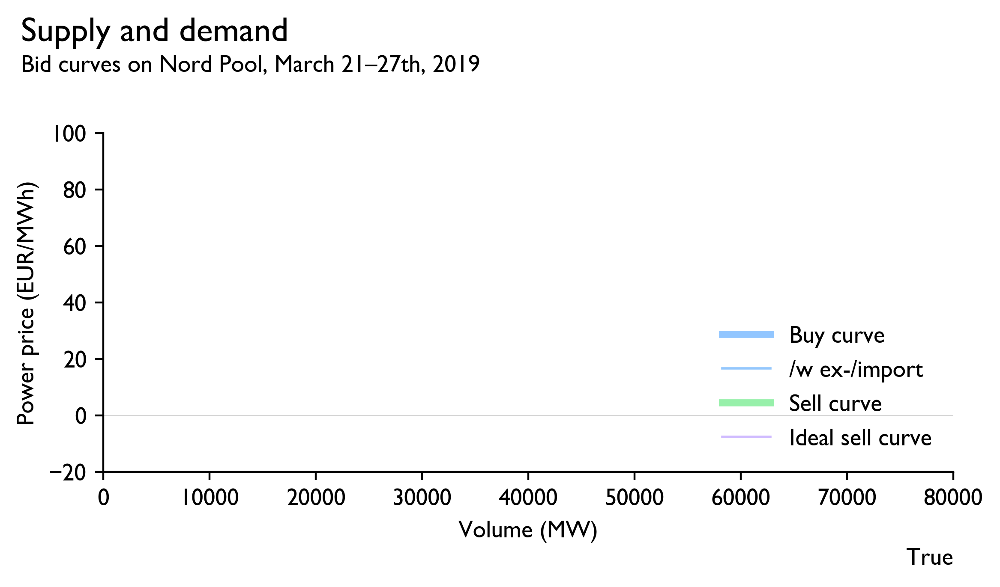

In [12]:
buy_and_sell_curve_for_plot = [buy_and_sell_curve for buy_and_sell_curve in buy_and_sell_curves 
     if   buy_and_sell_curve["date_time"] >= datetime.datetime(2019, 3, 21, 0, 0)
     and  buy_and_sell_curve["date_time"] <= datetime.datetime(2019, 3, 27, 23, 0)]

title = "Supply and demand"
title2 = "Bid curves on Nord Pool, March 21–27th, 2019"
path = "animations/5-normal-week-in-march-with-marginal-costs.mp4"
save_and_render_video_with_mc(buy_and_sell_curve_for_plot, path, title, title2, draw_past_interactions=True, points_back_in_time=7*24)
HTML("""<video src="{}" width="640" height="360" controls="true">""".format(path))